In [1]:
%matplotlib inline
import cv2
import numpy as np
import matplotlib.image as mpimg
import matplotlib.pyplot as plt
import scipy.misc
import glob
import imageio

/tmp/ipykernel_6513/2593840924.py:79: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = plt.figure(figsize=(12, 3))


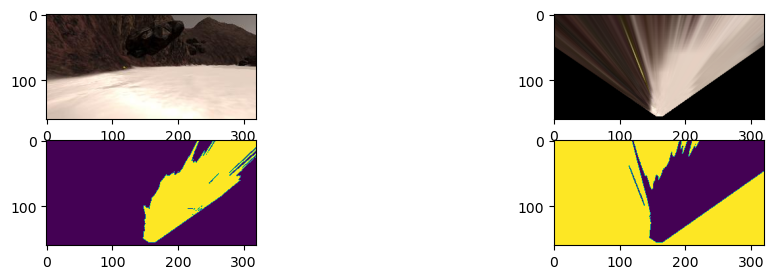

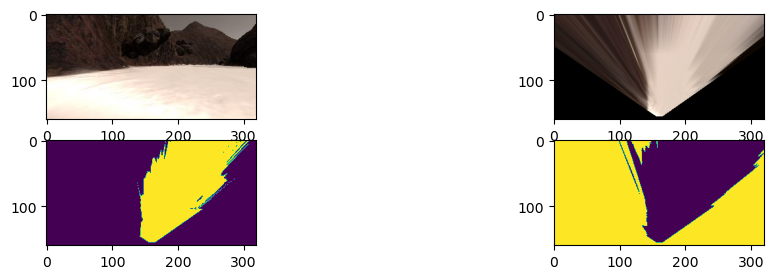

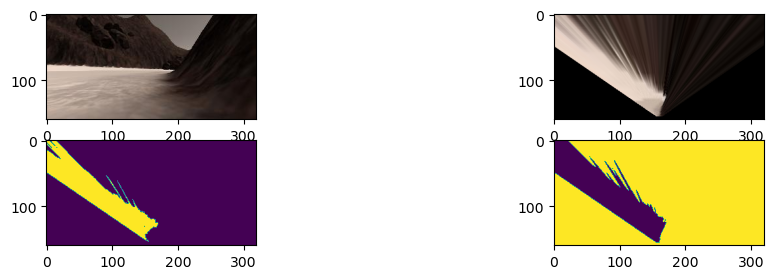

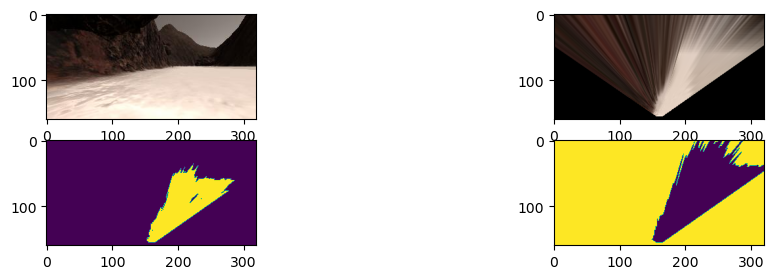

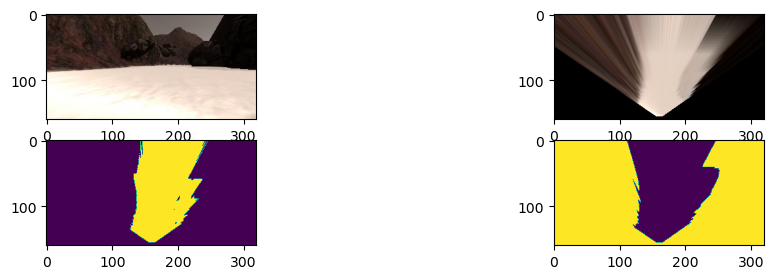

...

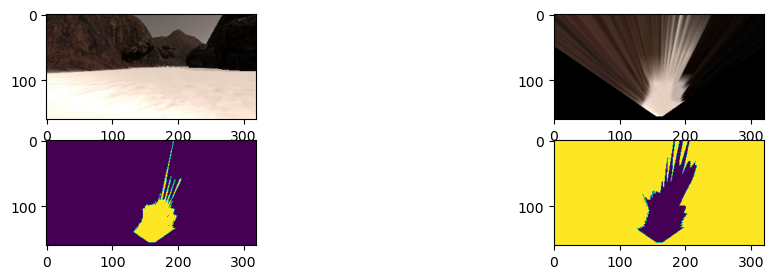

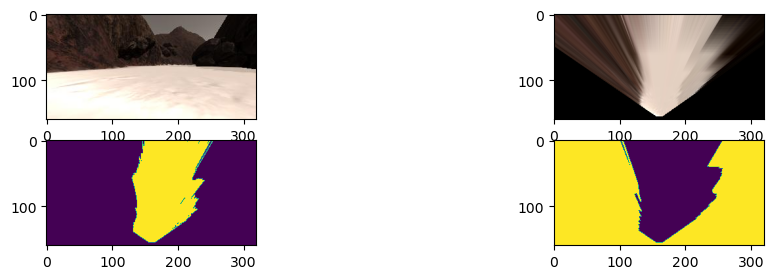

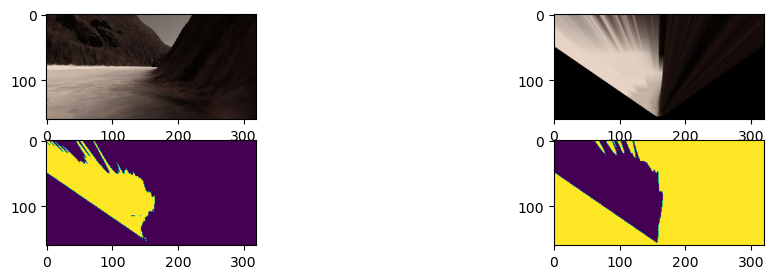

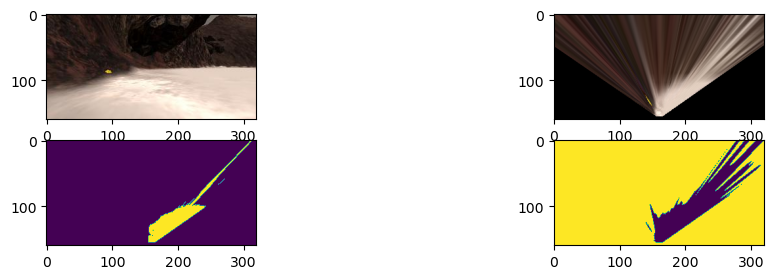

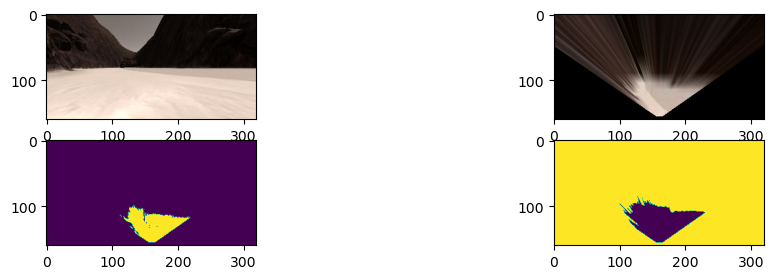

In [2]:
example_rock = "../calibration_images/example_rock1.jpg"
image = mpimg.imread(example_rock)

def perspect_transform(img, src, dst):
    M = cv2.getPerspectiveTransform(src, dst)
    warped = cv2.warpPerspective(img, M, (img.shape[1], img.shape[0]))
    return warped
def color_thresh(img, rgb_thresh=(160, 160, 160)):
    # Create an array of zeros same xy size as img, but single channel
    color_select = np.zeros_like(img[:,:,0])
    # Require that each pixel be above all three threshold values in RGB
    # above_thresh will now contain a boolean array with "True"
    # where threshold was met
    above_thresh = (img[:,:,0] > rgb_thresh[0]) \
                    & (img[:,:,1] > rgb_thresh[1]) \
                    & (img[:,:,2] > rgb_thresh[2])
        #200,200,3
    # Index the array of zeros with the boolean array and set to 1
    color_select[above_thresh] = 1
    # Return the binary image
    return color_select

def color_thresh_obs(img, rgb_thresh=(120, 120, 120)):
    # Create an array of zeros same xy size as img, but single channel
    color_select = np.zeros_like(img[:,:,0])
    # Require that each pixel be above all three threshold values in RGB
    # above_thresh will now contain a boolean array with "True"
    # where threshold was met
    above_thresh = (img[:,:,0] < rgb_thresh[0]) \
                    & (img[:,:,1] < rgb_thresh[1]) \
                    & (img[:,:,2] < rgb_thresh[2])
    # Index the array of zeros with the boolean array and set to 1
    color_select[above_thresh] = 1
    # Return the binary image
    return color_select

# Identify yellow rock sample
def color_thresh_rock(img):
    # yellow_hsv = [30,255,255] # H is 0-179 degree not 360
    # convert RGB image to HSV image
    hsv = cv2.cvtColor(img, cv2.COLOR_RGB2HSV)
    # define lowerbound and upperbound for yellow color
    lower_yellow = np.array([20, 100, 100])
    upper_yellow = np.array([40, 255, 255])
    # detect color in image by masking pixels
    mask = cv2.inRange(hsv, lower_yellow, upper_yellow)
    result = cv2.bitwise_and(img, img, mask=mask)
    # convert result to binary
    binary_result = color_thresh(result, (0, 0, 0))
    # return binary result
    return binary_result
    
    
path = '../test_dataset/IMG/*'
img_list = glob.glob(path)
dst_size = 5
bottom_offset = 5
source = np.float32([[14,140],
                         [300,140],
                         [200,95],
                         [120,95]])

destination = np.float32([[image.shape[1] / 2 - dst_size, image.shape[0] - bottom_offset],
                              [image.shape[1]/2 + dst_size, image.shape[0] - bottom_offset],
                              [image.shape[1]/2 + dst_size, image.shape[0] - 2*dst_size - bottom_offset],
                              [image.shape[1]/2 - dst_size, image.shape[0] - 2*dst_size - bottom_offset]])

for i in range(len(img_list)):
    image = mpimg.imread(img_list[i])
    
    image_transform = perspect_transform(image, source, destination)

    
    # 3) Apply color threshold to identify navigable terrain/obstacles/rock samples
    nav_train = color_thresh(image_transform,(160,160,160))
    obs       = color_thresh_obs(image_transform,(120,120,120))
    rock      = color_thresh_rock(image_transform)
    
    fig = plt.figure(figsize=(12, 3))
    plt.subplot(221)
    plt.imshow(image)
    plt.subplot(222)
    plt.imshow(image_transform)
    plt.subplot(223)
    plt.imshow(nav_train)
    plt.subplot(224)
    plt.imshow(obs)